In [90]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, UpSampling2D
from keras.optimizers import Adam
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score


In [91]:
image_folder = './Test cases/'
images = []
for filename in os.listdir(image_folder):
    img = cv2.imread(os.path.join(image_folder,filename), 0)
    if img is not None:
        # images.append(img)
images = np.array(images)


C:\Users\Jack\AppData\Local\Temp\ipykernel_8600\3321896033.py:7: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  images = np.array(images)


(197,)


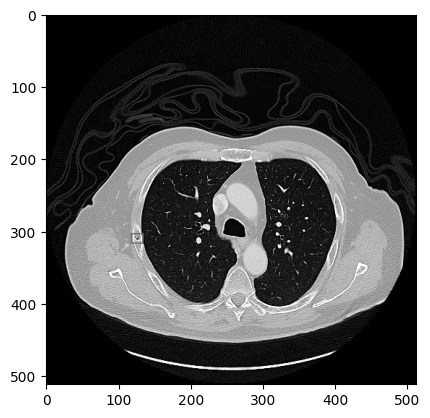

In [92]:
plt.imshow(images[196], cmap='gray')
# plt.show()
print(images.shape)


In [93]:
# Convert the list of images to a numpy array
images = np.array(images)

In [96]:
print(images.shape)

(197,)


In [94]:
# Normalize the images
images = images / 255.0

In [95]:
# Reshape the images to the desired shape
images = images.reshape(-1, images.shape[1], images.shape[2], 1)

IndexError: tuple index out of range

In [ ]:
# Define the CNN denoising model
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', padding='same', input_shape=images.shape[1:]),
    MaxPooling2D((2, 2), padding='same'),
    Conv2D(64, (3, 3), activation='relu', padding='same'),
    MaxPooling2D((2, 2), padding='same'),
    Conv2D(128, (3, 3), activation='relu', padding='same'),
    UpSampling2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu', padding='same'),
    UpSampling2D((2, 2)),
    Conv2D(32, (3, 3), activation='relu', padding='same'),
    Conv2D(1, (3, 3), activation='sigmoid', padding='same')
])

In [ ]:
# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy')

In [ ]:

# Define early stopping to prevent overfitting
early_stopping = EarlyStopping(patience=5, restore_best_weights=True)

In [ ]:
# Train the model
model.fit(images, images, epochs=50, batch_size=32, validation_split=0.2, callbacks=[early_stopping])

In [ ]:
# Denoise an image
test_image = images[0]
denoised_image = model.predict(np.array([test_image]))

In [ ]:
fig, ax = plt.subplots(1, 2)
ax[0].imshow(test_image.squeeze())
ax[0].set_title('Original')
ax[1].imshow(denoised_image.squeeze())
ax[1].set_title('Denoised')
plt.show()

C:\Users\Jack\AppData\Local\Temp\ipykernel_8600\540638237.py:43: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  images = np.array(images)


Epoch 1/10
13/13 [==============================] - 44s 2s/step - loss: 0.0744
Epoch 2/10
13/13 [==============================] - 31s 2s/step - loss: 0.0261
Epoch 3/10
13/13 [==============================] - 31s 2s/step - loss: 0.0115
Epoch 4/10
13/13 [==============================] - 31s 2s/step - loss: 0.0082
Epoch 5/10
13/13 [==============================] - 31s 2s/step - loss: 0.0071
Epoch 6/10
13/13 [==============================] - 31s 2s/step - loss: 0.0065
Epoch 7/10
13/13 [==============================] - 31s 2s/step - loss: 0.0061
Epoch 8/10
13/13 [==============================] - 32s 2s/step - loss: 0.0057
Epoch 9/10
13/13 [==============================] - 34s 3s/step - loss: 0.0054
Epoch 10/10
7/7 [==============================] - 8s 954ms/step


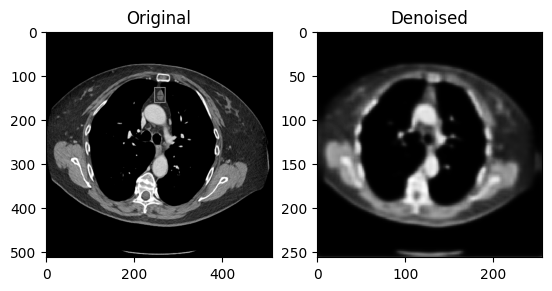

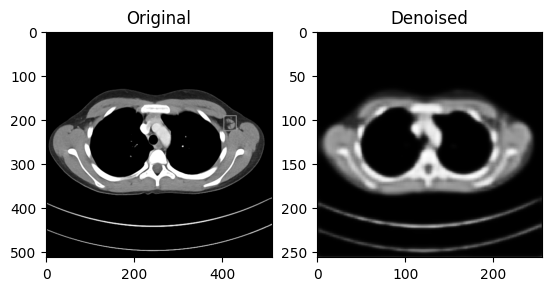

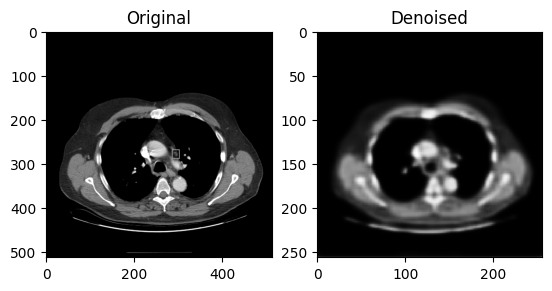

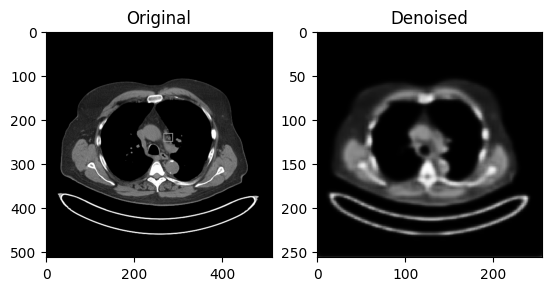

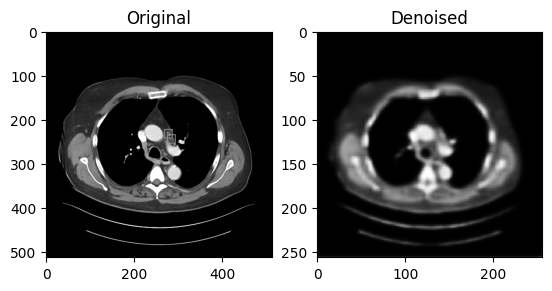

...

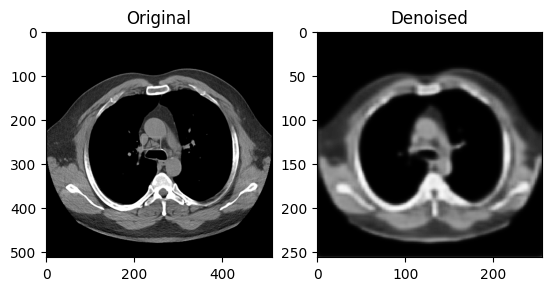

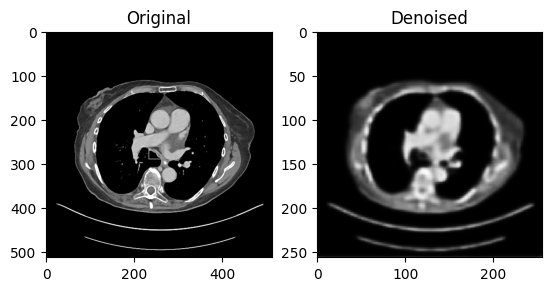

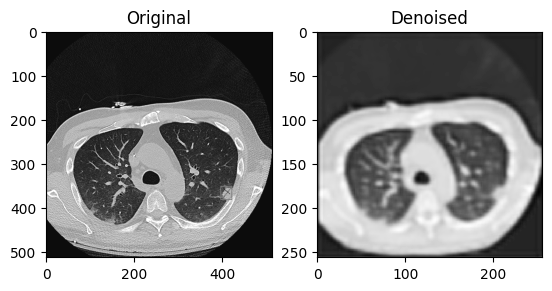

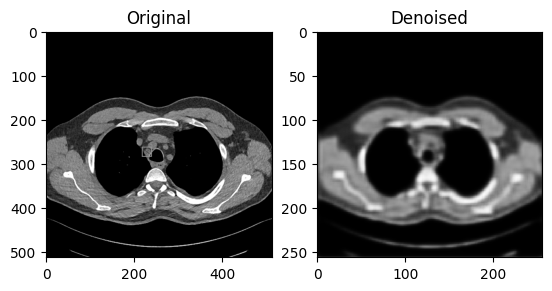

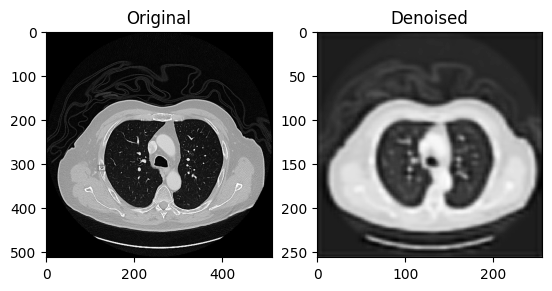

In [98]:
import os
import cv2
import numpy as np
import keras
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, UpSampling2D
from keras.optimizers import Adam

def your_denoising_function(images):
    # Define the CNN model
    model = Sequential()
    model.add(Conv2D(32, (3, 3), activation='relu', padding='same', input_shape=images[0].shape))
    model.add(MaxPooling2D((2, 2), padding='same'))
    model.add(Conv2D(32, (3, 3), activation='relu', padding='same'))
    model.add(MaxPooling2D((2, 2), padding='same'))
    model.add(Conv2D(32, (3, 3), activation='relu', padding='same'))
    model.add(UpSampling2D((2, 2)))
    model.add(Conv2D(32, (3, 3), activation='relu', padding='same'))
    model.add(UpSampling2D((2, 2)))
    model.add(Conv2D(1, (3, 3), activation='sigmoid', padding='same'))

    # Compile the model
    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')

    # Train the model
    model.fit(images, images, epochs=10, batch_size=16)

    # Use the trained model to denoise the input images
    denoised_images = model.predict(images)

    return denoised_images


# Load the images from the specified folder
image_folder = './Test cases/'
images = []
for filename in os.listdir(image_folder):
    img = cv2.imread(os.path.join(image_folder,filename), 0)
    if img is not None:
        images.append(img)

# Convert the list of images to a numpy array
images = np.array(images)

# Normalize the images
images = images / 255.0

# Resize the images to the desired shape
height, width, channels = 256, 256, 1
resized_images = np.zeros((images.shape[0], height, width, channels))
for i in range(images.shape[0]):
    resized_images[i] = cv2.resize(images[i], (width, height)).reshape(height, width, channels)

# Apply the CNN denoising algorithm
denoised_images = your_denoising_function(resized_images)

# Visualize the results
for i in range(images.shape[0]):
    fig, ax = plt.subplots(1, 2)
    ax[0].imshow(images[i], cmap='gray')
    ax[0].set_title('Original')
    ax[1].imshow(denoised_images[i].squeeze(), cmap='gray')
    ax[1].set_title('Denoised')
    plt.show()
